# Reproduction of Ganspace

Reproduction of [GANSpace: Discovering Interpretable GAN Controls](https://arxiv.org/abs/2004.02546) in Tensorflow 1.x

# Setup

Clone the repository and install the required packages

In [2]:
#@title Install the required packages (Please manually restart runtime after installation)
!pip install dvc==2.3.0

In [3]:
#@title Use Tensorflow 1.x
#Set the tensorflow version to 1.x
%tensorflow_version 1.x

In [4]:
#@title Clone the repository
#Clone: https://dagshub.com/midsterx/Re-GANSpace
!git clone https://dagshub.com/midsterx/Re-GANSpace
%cd Re-GANSpace

Cloning into 'Re-GANSpace'...
remote: Enumerating objects: 362, done.
remote: Counting objects: 100% (362/362), done.
remote: Compressing objects: 100% (348/348), done.
remote: Total 362 (delta 100), reused 167 (delta 10)
Receiving objects: 100% (362/362), 105.65 MiB | 24.31 MiB/s, done.
Resolving deltas: 100% (100/100), done.
/content/Re-GANSpace


In [5]:
#@title (Optional but recommended) Download StyleGAN/StyleGAN2 pretrained models using DVC
!dvc pull -r origin

Streaming output truncated to the last 5000 lines.


          |154M [00:29,    6.84MB/s]

          |112M [00:20,    6.21MB/s]





          |97.3M [00:17,    5.88MB/s]


          |151M [00:28,    6.36MB/s]




          |130M [00:25,    6.28MB/s]



          |155M [00:29,    7.10MB/s]

          |112M [00:20,    6.11MB/s]





          |97.9M [00:17,    5.22MB/s]


          |151M [00:28,    6.47MB/s]




          |131M [00:25,    6.60MB/s]



          |155M [00:30,    6.99MB/s]

          |113M [00:20,    6.22MB/s]





          |98.5M [00:17,    5.47MB/s]


          |152M [00:28,    6.48MB/s]




          |132M [00:25,    6.46MB/s]

          |114M [00:20,    6.31MB/s]



          |156M [00:30,    6.37MB/s]





          |99.1M [00:17,    5.68MB/s]

          |115M [00:21,    6.92MB/s]
          |182M [00:34,    6.88MB/s]


          |152M [00:28,    5.94MB/s]



          |157M [00:30,    6.38MB/s]





          |99.8M [00:17,    6.10MB/s]
          |183M [00:34,    6.

In [6]:
#@title Import IPython function to render images and change directories
#Import helper function to render images in notebook
from IPython.display import Image
%cd figures

/content/Re-GANSpace/figures


# Reproduce StyleGAN/StyleGAN2 figures

In the following sections, we reproduce the StyleGAN/StyleGAN2 results. The figure numbers correspond to those of the original [paper](https://arxiv.org/abs/2004.02546).

## Figure 1

In this section, we experiment with StyleGAN2 pretrained on the FFHQ and Cars dataset. We apply a sequence of edits using the controls discovered with GANSpace. For more details, refer to section 1 of the paper.

The figure below highlights a sequence of edits that affect the object pose and colour, and landscape attributes of an image generated using StyleGAN2 Cars.

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Compiling... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Compiling... Loading... Done.
2021-10-08 18:10:48.748553: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 16777216 exceeds 10% of system memory.
[08.10 18:10] Computing stylegan2-cars_ipca_c80_n1000000_w.npz
Using W latent space
Feature shape:  (1, 512)
Feature dims:  512
B=200, N=1000000, dims=512, N/dims=1953.1
tcmalloc: large alloc 2052096000 bytes == 0x55eb38b48000 @  0x7f88d3f50001 0x7f88d09da54f 0x7f88d0a2ab58 0x7f88d0a2eb17 0x7f88d0acd203 0x55eb02292544 0x55eb02292240 0x55eb02306627 0x55eb02293afa 0x55eb02301915 0x55eb023009ee 0x55eb02293bda 0x55eb02302737 0x55eb023009ee 0x55eb023006f3 0x55eb023ca4c2 0x55eb023ca83d 0x55eb023ca6e6 0x55eb023a2163 0x55eb023a1e0c 0x7f88d2d38bf7 0x55eb023a1cea
Sampling latents: 100% 5010/5010 [00:39<00:00, 125.66it/s]
Fitting batches (NB=2000): 100% 500/500 [03:10<00:00,  2

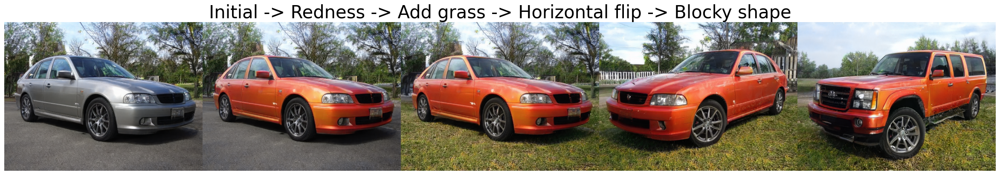

In [7]:
!python figure_1.py
#Show the first row of Figure 1
Image('results/figure1_StyleGAN2_cars.png')

The following figure is an image generated using StyleGAN2 FFHQ. The sequence of edits affect facial attributes and lighting.

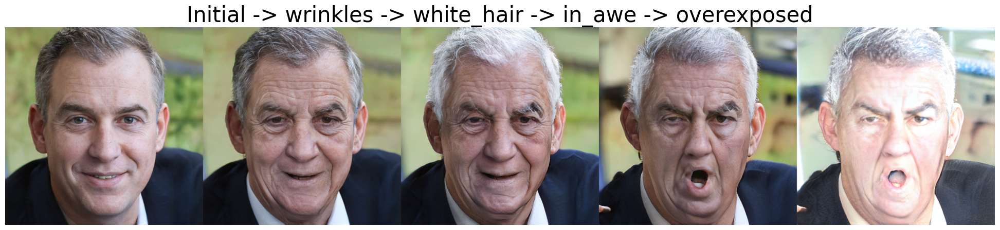

In [8]:
#Show the second row of Figure 1
Image('results/figure1_StyleGAN2_ffhq.png')

## Figure 3

This figure illustrates the effect of variations along the principal components in the intermediate latent space of StyleGAN2 FFHQ. For more details, refer to section 2.2 of the paper.

The figure below illustrates the 14 largest principal components in the intermediate latent space. They span the major variations expected of portrait photographs—such as gender and head rotation—with a few effects typically entangled together. The variation is applied to all layers of StyleGAN2 synthesis network.

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.


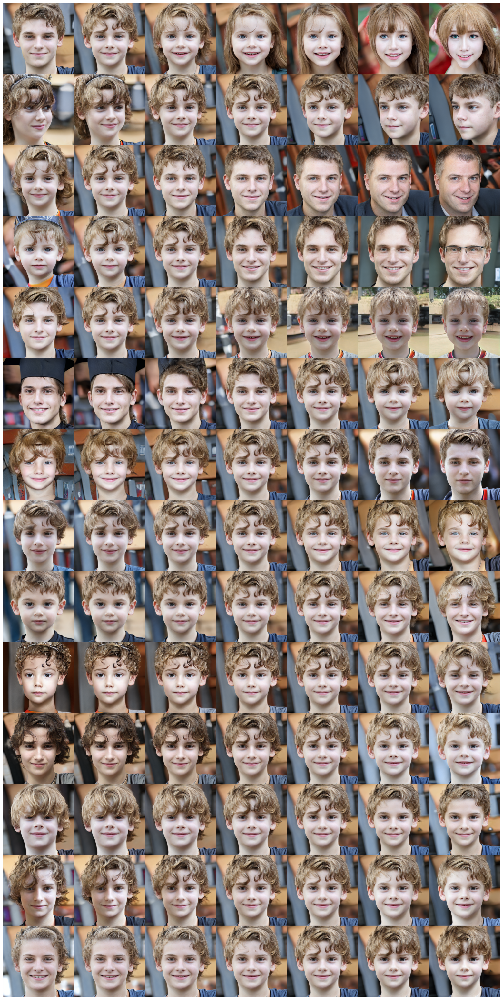

In [9]:
!python figure_3.py
#Show first part of Figure 3
Image('results/figure3_normal_centered_pcs.png')

The following figure demonstrate the effect of constraining the variation to a subset of the layers. The selective application of the principal components allows control of features such as hair color, aspects of hairstyle, and lighting.

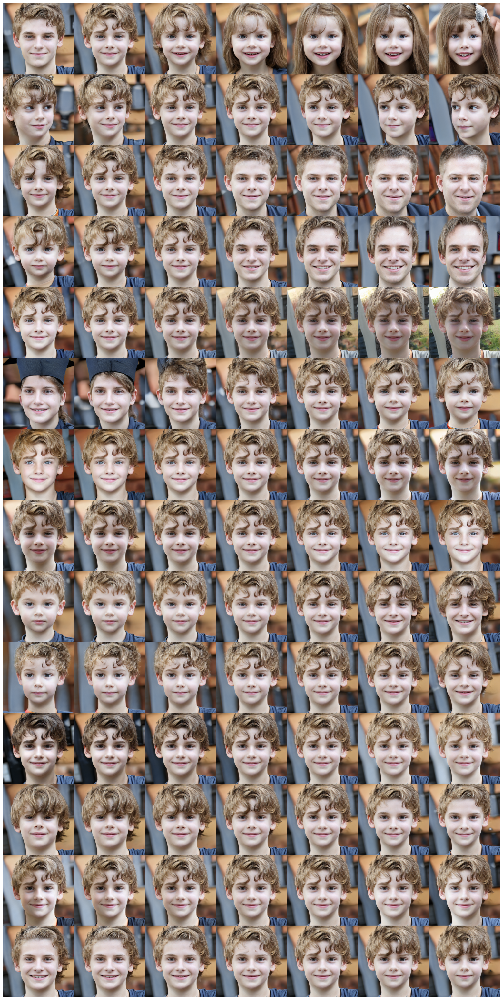

In [10]:
#Show second part of Figure 3
Image('results/figure3_hand_tuned.png')

## Figure 4

This figure illustrates the significance of the principal components as compared to random directions in the intermediate latent space of StyleGAN2 Cats. Fixing and randomizing the early principal components shows a separation between pose and style (a, b). In contrast, fixing and randomizing randomly-chosen directions does not yield a similar meaningful decomposition (c, d). For more details, refer section 3.2 of the paper.

a) Fix first 8 PCA coord., randomize remaining 504 (Pose and camera fixed, appearance changes)

b) Randomize first 8 PCA coord., fix remaining 504 (Appearance fixed, pose changes)

c) Fix 8 random basis coord., randomize the others (Almost everything changes)

d) Randomize 8 random basis coord., fix remaining 504 (Almost nothing changes)

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.
[08.10 18:23] Computing stylegan2-cats_ipca_c512_n1000000_w.npz
Using W latent space
Feature shape:  (1, 512)
Feature dims:  512
B=500, N=1000000, dims=512, N/dims=1953.1
tcmalloc: large alloc 2052096000 bytes == 0x5596e02ca000 @  0x7fc6a0df5001 0x7fc69d87f54f 0x7fc69d8cfb58 0x7fc69d8d3b17 0x7fc69d972203 0x5596ab2ac544 0x5596ab2ac240 0x5596ab320627 0x5596ab2adafa 0x5596ab31b915 0x5596ab31a9ee 0x5596ab2adbda 0x5596ab31c737 0x5596ab31a9ee 0x5596ab31a6f3 0x5596ab3e44c2 0x5596ab3e483d 0x5596ab3e46e6 0x5596ab3bc163 0x5596ab3bbe0c 0x7fc69fbddbf7 0x5596ab3bbcea
Sampling latents: 100% 2004/2004 [00:31<00:00, 63.50it/s]
Fitting batches (NB=2000): 100% 500/500 [03:25<00:00,  2.43it/s]
Seeds: 1866827965 - 1866827971


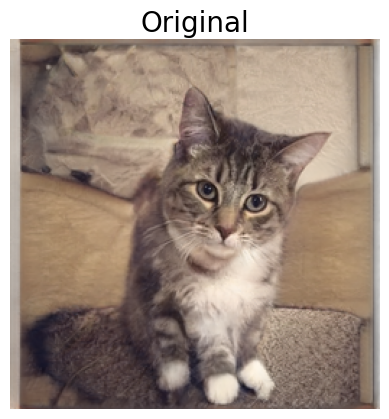

In [11]:
!python figure_4.py
#Original image
Image('results/figure4_original.png')

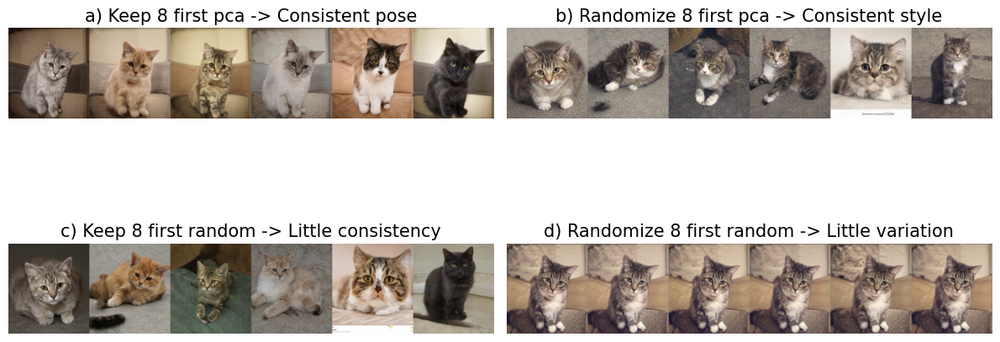

In [12]:
#Show Figure 4
Image('results/figure4_randomize_8_first_random-little_variation.png')

## Figure 5

This figure illustrates the efficacy of GANSpace as compared to other supervised learning techniques in identifying edit directions. For more details, refer to section 3.3 of the paper.

The figure belows shows the change in pose on an image generated using StyleGAN FFHQ.

[08.10 18:27] Computing stylegan2-ffhq_ipca_c128_n1000000_w.npz
Using W latent space
Feature shape:  (1, 512)
Feature dims:  512
B=20, N=1000000, dims=512, N/dims=1953.1
tcmalloc: large alloc 2052096000 bytes == 0x55e898164000 @  0x7f8b39efb001 0x7f8b3698554f 0x7f8b369d5b58 0x7f8b369d9b17 0x7f8b36a78203 0x55e864852544 0x55e864852240 0x55e8648c6627 0x55e864853afa 0x55e8648c1915 0x55e8648c09ee 0x55e864853bda 0x55e8648c2737 0x55e8648c09ee 0x55e8648c06f3 0x55e86498a4c2 0x55e86498a83d 0x55e86498a6e6 0x55e864962163 0x55e864961e0c 0x7f8b38ce3bf7 0x55e864961cea
Sampling latents: 100% 50100/50100 [02:28<00:00, 336.83it/s]
Fitting batches (NB=2000): 100% 500/500 [03:09<00:00,  2.64it/s]
Seed: 129888612
Seed: 70163682
[08.10 18:33] Computing stylegan2-celebahq_ipca_c128_n1000000_w.npz
Using W latent space
Feature shape:  (1, 512)
Feature dims:  512
B=20, N=1000000, dims=512, N/dims=1953.1
tcmalloc: large alloc 2052096000 bytes == 0x55e8c872c000 @  0x7f8b39efb001 0x7f8b3698554f 0x7f8b369d5b58 0x7f

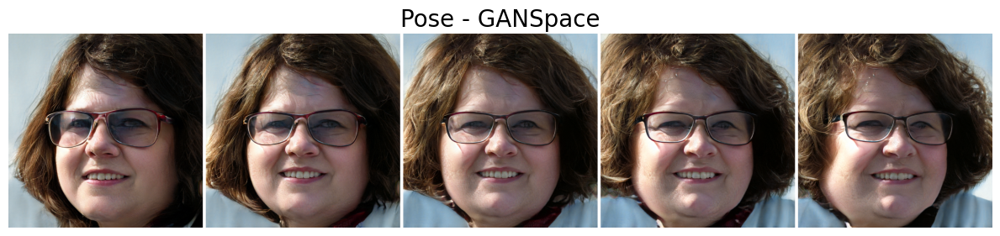

In [13]:
!python figure_5.py
#Show figure 5c) GANSpace
Image('results/figure5_Pose-GANSpace_scale=-1.0.png')

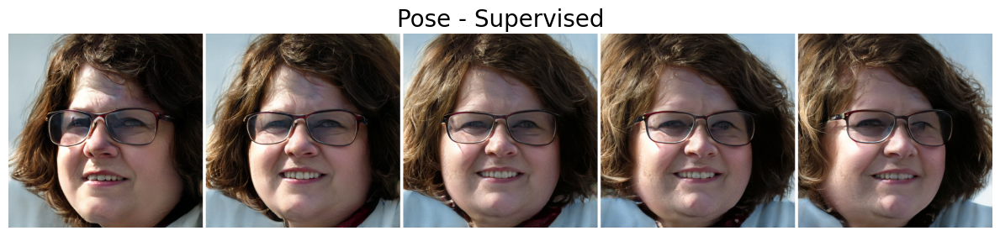

In [14]:
#Show figure 5c) Supervised
Image('results/figure5_Pose-Supervised_scale=1.0.png')

The following figures show the change in expression of an image generated using StyleGAN FFHQ.

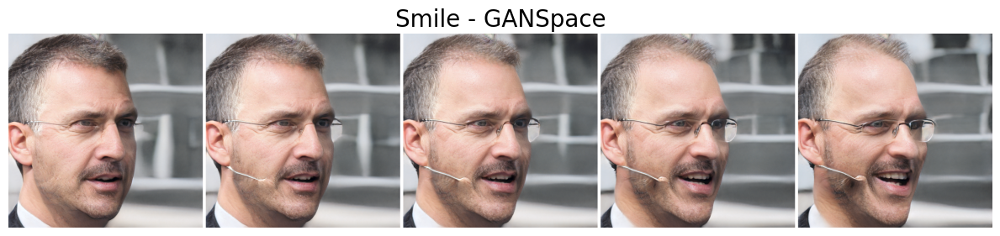

In [15]:
#Show figure 5d) GANSpace
Image('results/figure5_Smile-GANSpace_scale=-8.5.png')

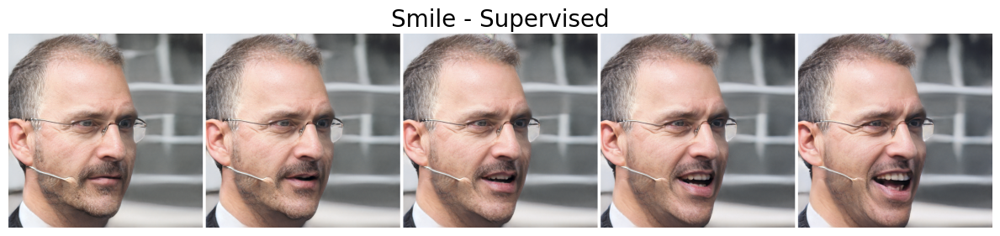

In [16]:
#Show figure 5d) Supervised
Image('results/figure5_Smile-Supervised_scale=1.0.png')

The following figures show the change in appearance on an image generated using StyleGAN CelebaHQ. Specifically, we can see eye glasses being added.

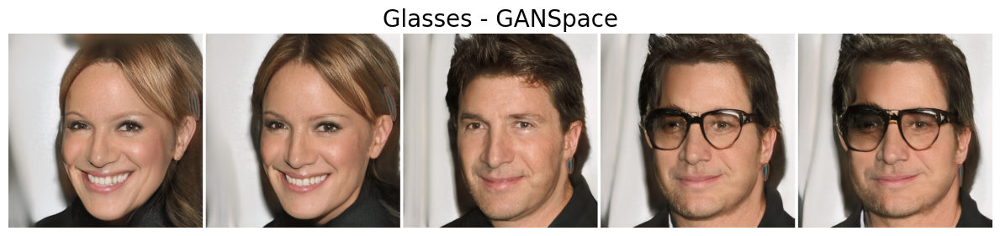

In [17]:
#Show figure 5e) GANSpace
Image('results/figure5_Glasses-GANSpace_scale=-10.0.png')

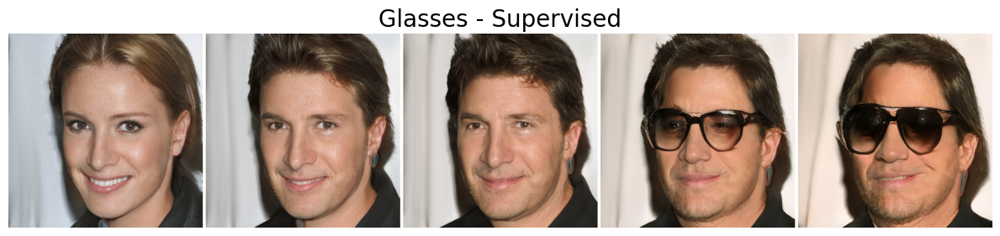

In [18]:
#Show figure 5e) Supervised
Image('results/figure5_Glasses-Supervised_scale=2.0.png')

The figures below shows the change in gender on an image generated using StyleGAN CelebaHQ. Specifically, we can see the person becoming more masculine.

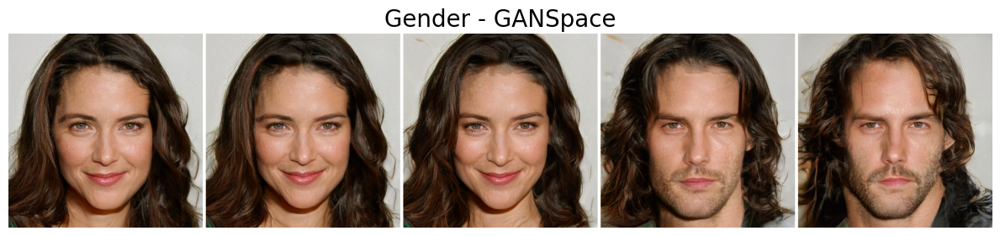

In [19]:
#Show figure 5f) GANSpace
Image('results/figure5_Gender-GANSpace_scale=-3.2.png')

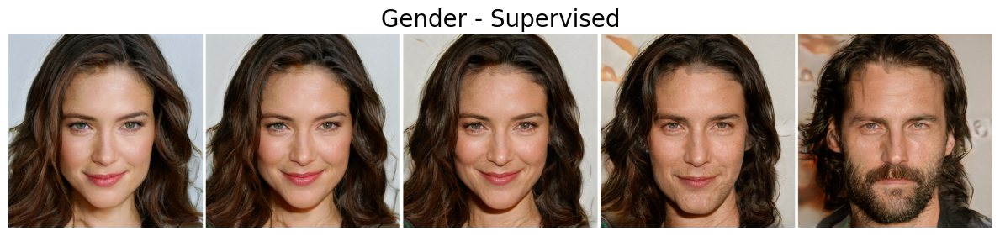

In [20]:
#Show figure 5f) Supervised
Image('results/figure5_Gender-Supervised_scale=1.2.png')

## Figure 7

This figure shows selection of interpretable edits discovered by selective application of latent edits across the layers of several pretrained GAN models. For more details, refer to section 3.3 of the paper.

This figures shows edits that affect the amount of reflected light on an image from StyleGAN2 Cars

[08.10 18:40] Computing stylegan1-wikiart_ipca_c80_n1000000_w.npz
Using W latent space
Feature shape:  (1, 512)
Feature dims:  512
B=20, N=1000000, dims=512, N/dims=1953.1
tcmalloc: large alloc 2052096000 bytes == 0x55e36bc74000 @  0x7efd3d6f5001 0x7efd3a17f54f 0x7efd3a1cfb58 0x7efd3a1d3b17 0x7efd3a272203 0x55e33acc3544 0x55e33acc3240 0x55e33ad37627 0x55e33acc4afa 0x55e33ad32915 0x55e33ad319ee 0x55e33acc4bda 0x55e33ad33737 0x55e33ad319ee 0x55e33ad316f3 0x55e33adfb4c2 0x55e33adfb83d 0x55e33adfb6e6 0x55e33add3163 0x55e33add2e0c 0x7efd3c4ddbf7 0x55e33add2cea
Sampling latents: 100% 50100/50100 [02:26<00:00, 342.82it/s]
Fitting batches (NB=2000): 100% 500/500 [02:56<00:00,  2.84it/s]
Configs: ('StyleGAN', 'g_mapping', 'latent', 'w', 0, 2, 'wikiart', -2.9, 7, 'Head rotation', [1819967864])
StyleGAN, g_mapping, Head rotation
Seeds: [1819967864]
Configs: ('StyleGAN', 'g_mapping', 'latent', 'w', 8, 15, 'wikiart', 7.5, 9, 'Simple strokes', [1239190942])
StyleGAN, g_mapping, Simple strokes
Seeds:

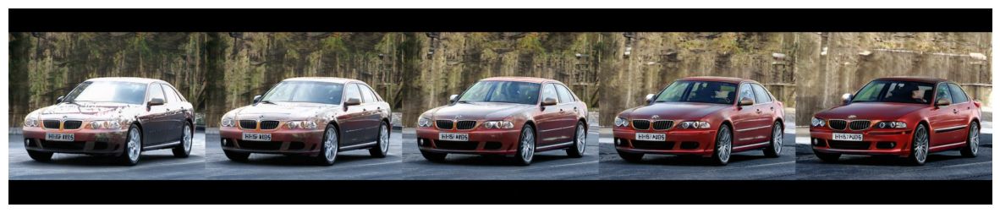

In [21]:
!python figure_7.py
Image('results/figure7_StyleGAN2_car_Reflections.png')

This figure shows edits that make a rider appear on an image from StyleGAN2 Horse.

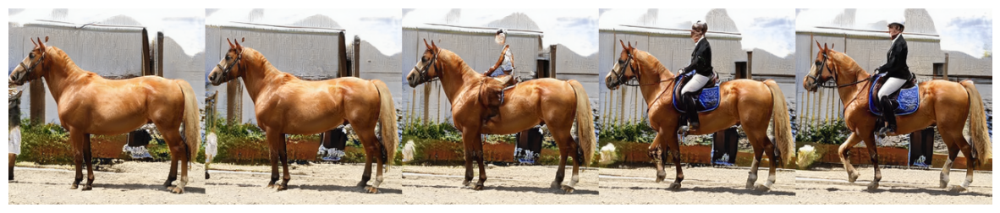

In [22]:
Image('results/figure7_StyleGAN2_horse_Add-rider.png')

This figure shows edits that make the head of person rotate in an image from StyleGAN Wikiart.

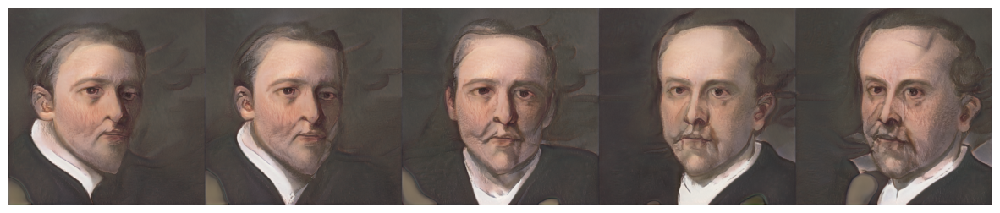

In [23]:
Image('results/figure7_StyleGAN_wikiart_Head-rotation.png')

This figure shows edits that make a cat fluffy in an image from StyleGAN2 Cats.

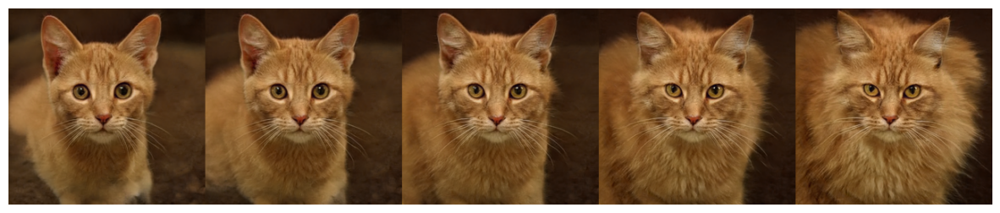

In [24]:
Image('results/figure7_StyleGAN2_cat_Fluffiness.png')

This figure shows edits that add makeup to the person in an image from StyleGAN2 FFHQ.

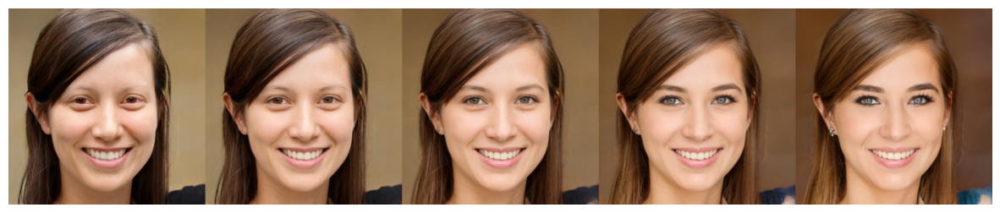

In [25]:
Image('results/figure7_StyleGAN2_ffhq_Makeup.png')

This figure shows edits that change the stroke style of an image from StyleGAN Wikiart.

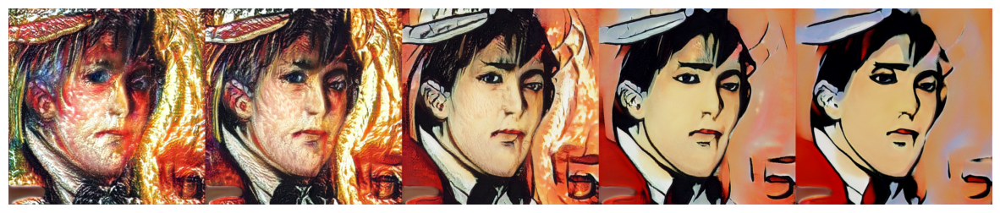

In [26]:
Image('results/figure7_StyleGAN_wikiart_Simple-strokes.png')